# Annotations using clustering for cells for kidney_s1

In [1]:
slide_id = "kidney_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_kidney_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 27323, 8832), (3, 13662, 4416)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (56510, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (56510, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (56510, 377)
      └── 'table_nuclei': AnnData (56510, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 56510 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,36,0,0,0,0,36,182.611882,20.817032,cell_labels
1,aaaaaaab-1,203,0,0,0,0,203,772.713778,41.272814,cell_labels
2,aaaaaaac-1,208,0,0,0,0,208,520.109706,63.038127,cell_labels
3,aaaaaaad-1,98,0,1,0,0,99,774.520028,27.680782,cell_labels
4,aaaaaaae-1,139,0,0,1,0,140,948.958628,43.124220,cell_labels
...,...,...,...,...,...,...,...,...,...,...
56505,aaaanmlj-1,52,0,0,0,0,52,90.673753,26.461563,cell_labels
56506,aaaanmlk-1,43,0,0,0,0,43,228.084227,18.062501,cell_labels
56507,aaaanmll-1,96,0,0,0,0,96,217.382195,29.577345,cell_labels
56508,aaaanmlm-1,49,0,0,0,0,49,158.769381,10.972969,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
UPK3B,ENSG00000243566,Gene Expression,Unknown
VCAN,ENSG00000038427,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 49356 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,19.349587,Renal epithelial cell - proximal tubules,29,1,2,3,2,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,38.653611,Fibroblast,52,2,2,3,2,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,51.817011,Renal epithelial cell - proximal tubules,118,1,3,0,3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,25.445590,Podocyte,55,0,4,2,4,T,T,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,40.550211,Fibroblast,63,2,2,3,2,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaanmlj-1,nucleus_boundaries,morpho,aaaanmlj-1,24.475175,Plasma cell,45,0,0,1,0,T,T_CD8,normal_cell
aaaanmlk-1,nucleus_boundaries,morpho,aaaanmlk-1,16.459098,B cell,30,1,1,4,1,Unknown,Unknown,normal_cell
aaaanmll-1,nucleus_boundaries,morpho,aaaanmll-1,26.709159,Plasma cell,38,1,3,0,3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaaanmlm-1,nucleus_boundaries,morpho,aaaanmlm-1,9.934933,Fibroblast,17,1,1,4,1,Unknown,Unknown,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.032446,0.418689
ACE2,0.111976,0.770495
ACKR1,0.194597,1.009754
ACTA2,1.037645,2.275497
ACTG2,1.304487,2.388944
...,...,...
UPK3B,0.048667,0.511731
VCAN,1.464447,2.594851
VSIG4,0.651791,1.796377
VWA5A,0.399442,1.417323


## 2. Preprocessing

<Axes: >

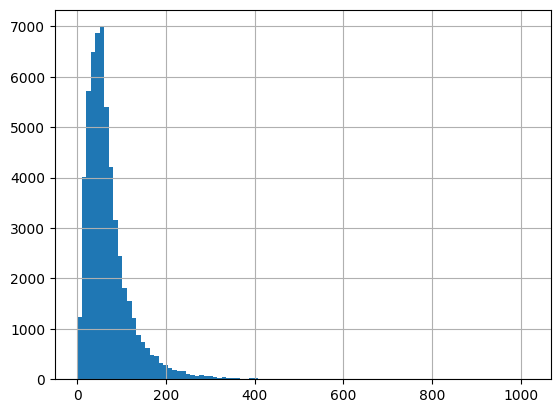

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

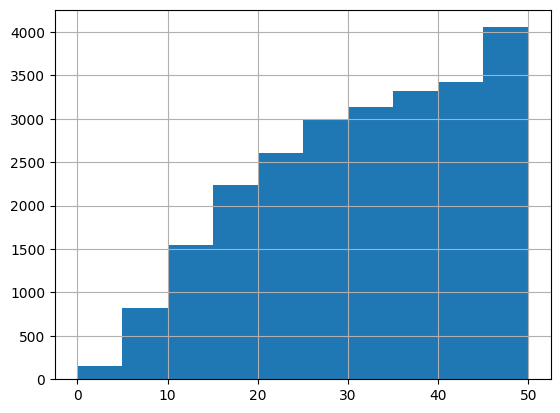

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 4755
Percentage of cells with less than 20 transcripts: 8.41%
-----
Number of cells with less than 15 transcripts: 2516
Percentage of cells with less than 15 transcripts: 4.45%
-----
Number of cells with less than 10 transcripts: 974
Percentage of cells with less than 10 transcripts: 1.72%
-----
Number total of cells: 56510


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

55278


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


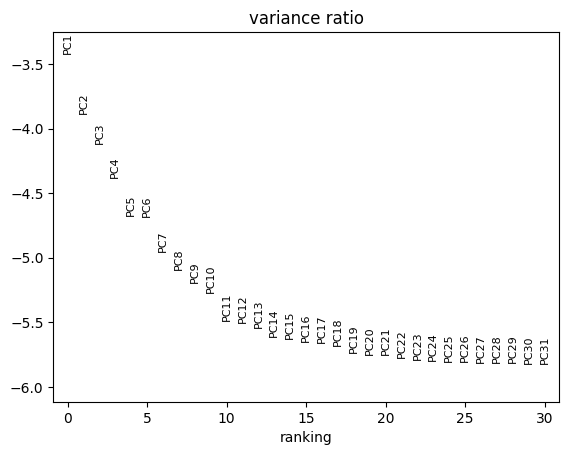

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 55278 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4453/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


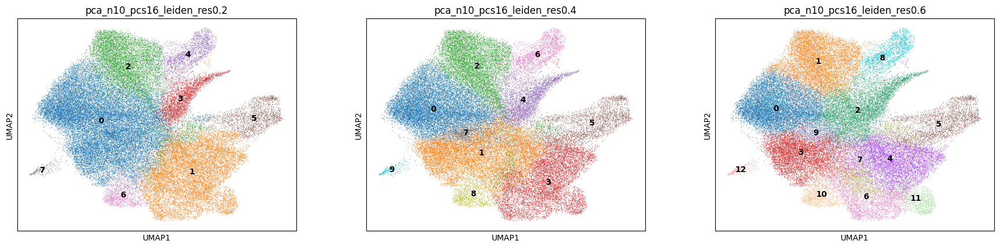

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['2', '6', '7', '5', '3', ..., '12', '1', '9', '8', '11']
Length: 13
Categories (13, object): ['0', '1', '2', '3', ..., '9', '10', '11', '12']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'

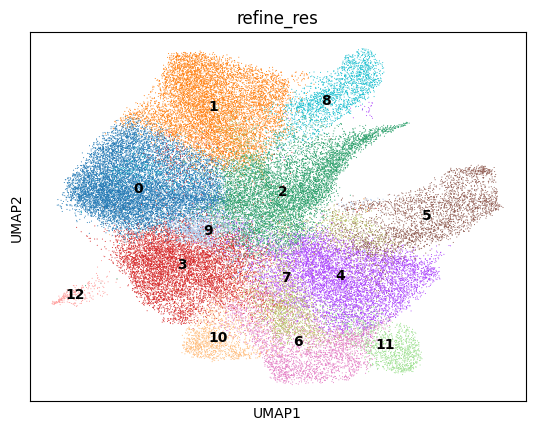

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

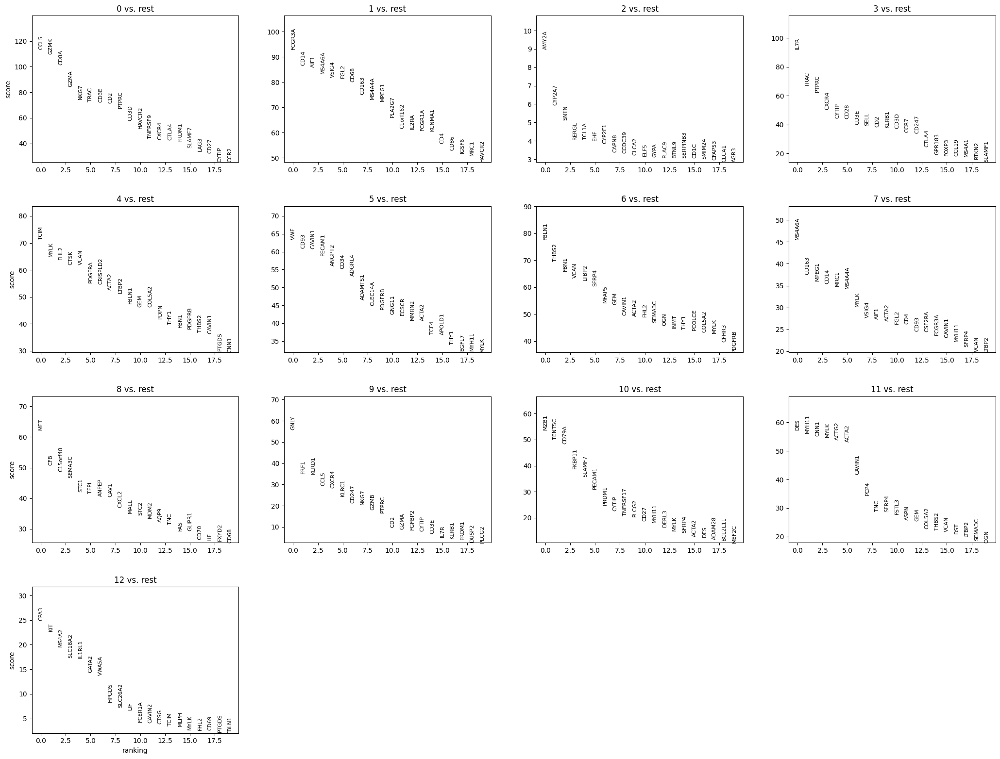

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [31]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T_CD8,normal_cell,75.8
1,Unknown,Unknown,normal_cell,13.1
2,T,T,normal_cell,5.9
3,NA,NA,NA,2.3
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.3


In [33]:
top_ranked_genes[cluster_id]

0    CCL5
1    GZMK
2    CD8A
3    GZMA
4    NKG7
5    TRAC
6    CD3E
Name: 0, dtype: object

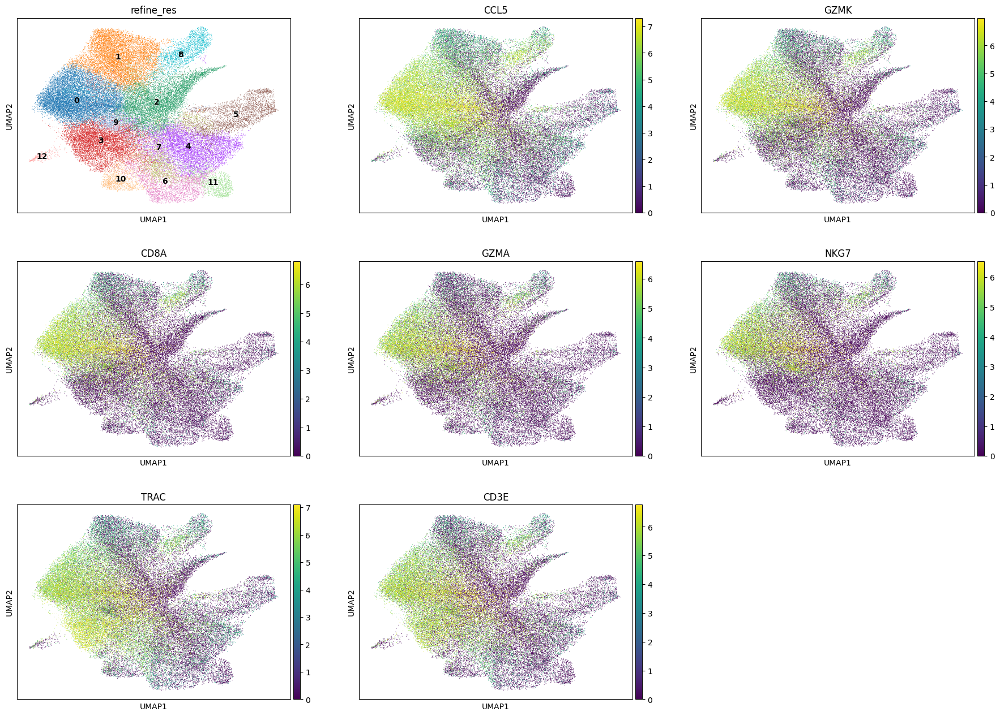

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 10639
Percentage of cells in cluster 0: 19.2


In [36]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,70.8
1,Unknown,Unknown,normal_cell,10.6
2,T,T_CD8,normal_cell,10.0
3,NA,NA,NA,5.1
4,T,T,normal_cell,2.4


In [39]:
top_ranked_genes[cluster_id]

0    FCGR3A
1      CD14
2      AIF1
3    MS4A6A
4     VSIG4
5      FGL2
6      CD68
Name: 1, dtype: object

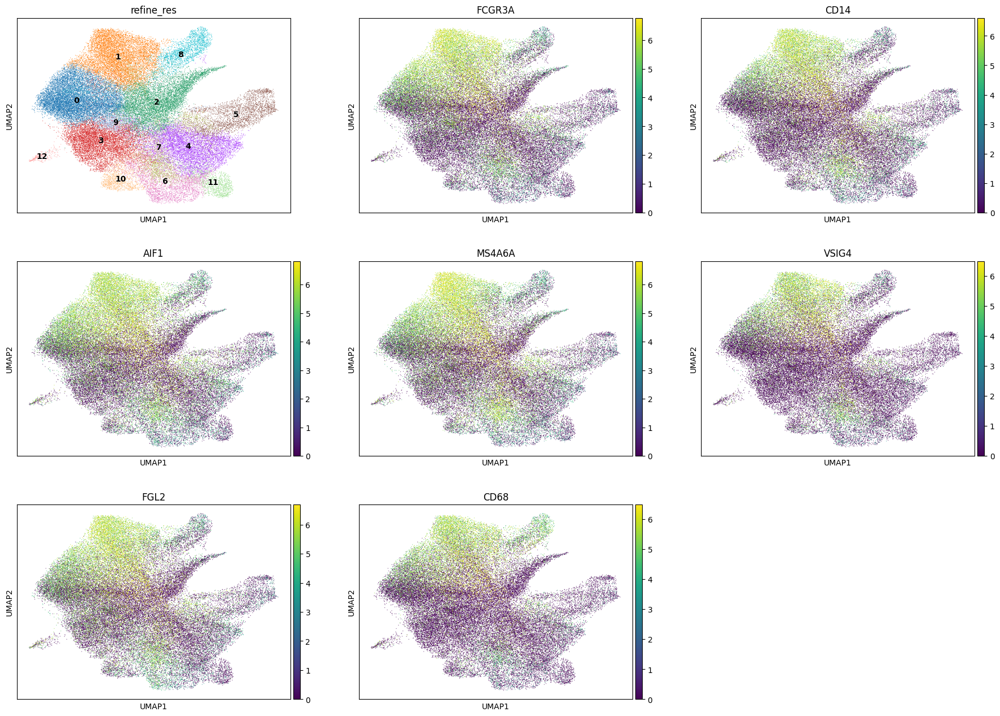

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 7655
Percentage of cells in cluster 1: 13.8


In [42]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Unknown,Unknown,normal_cell,52.2
1,NA,NA,NA,31.4
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,6.0
3,T,T,normal_cell,3.7
4,T,T_CD8,normal_cell,2.4


In [45]:
top_ranked_genes[cluster_id]

0     AMY2A
1    CYP2A7
2      SNTN
3     RERGL
4     TCL1A
5       EHF
6    CYP2F1
Name: 2, dtype: object

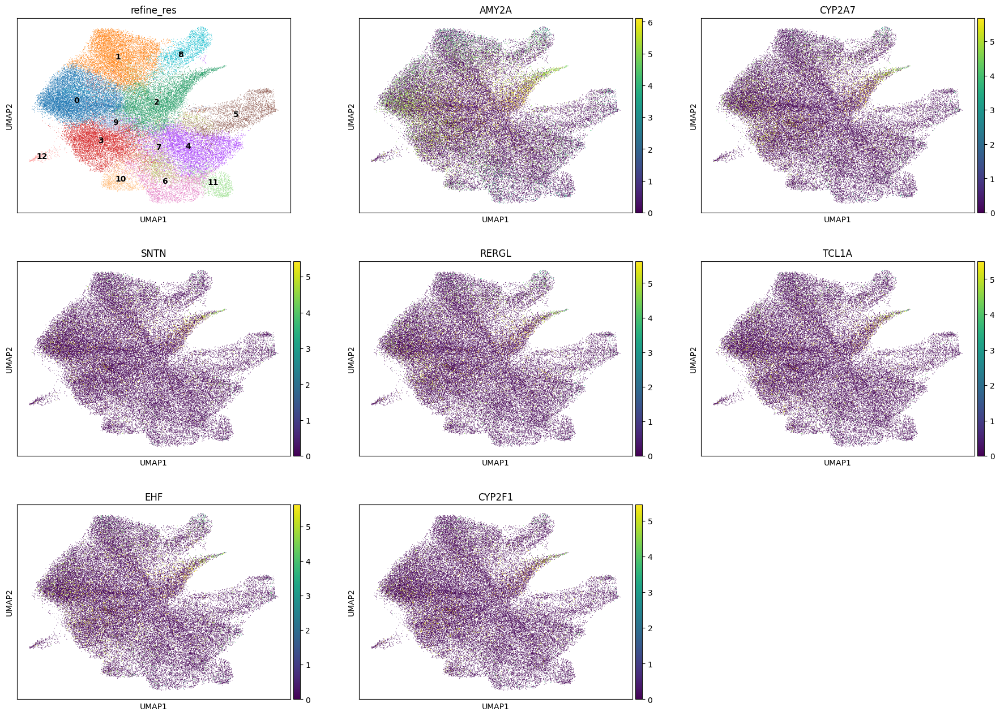

In [46]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 7534
Percentage of cells in cluster 2: 13.6


In [48]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Renal_epithelial_cell'

### 5.4. Cluster 3

In [49]:
cluster_id = '3'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,68.7
1,Unknown,Unknown,normal_cell,10.5
2,T,T_CD8,normal_cell,6.9
3,B,B,normal_cell,5.9
4,NA,NA,NA,3.2


In [51]:
top_ranked_genes[cluster_id]

0     IL7R
1     TRAC
2    PTPRC
3    CXCR4
4    CYTIP
5     CD28
6     CD3E
Name: 3, dtype: object

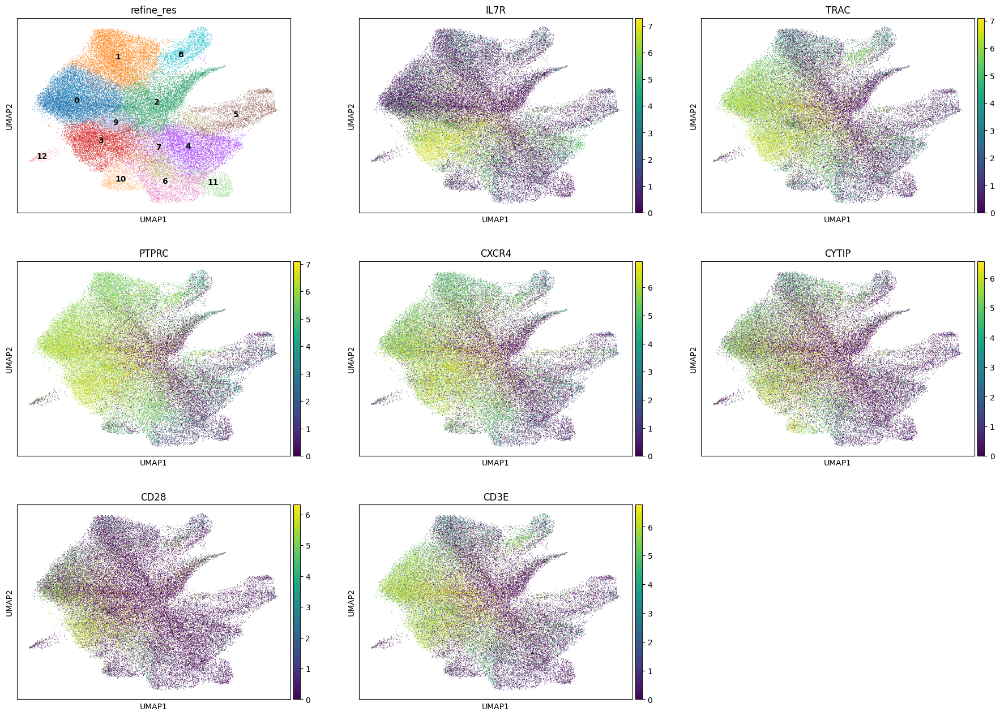

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 7260
Percentage of cells in cluster 3: 13.1


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.5. Cluster 4

In [55]:
cluster_id = '4'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,56.7
1,NA,NA,NA,21.1
2,Unknown,Unknown,normal_cell,10.1
3,T,T_CD8,normal_cell,5.1
4,T,T,normal_cell,3.6


In [57]:
top_ranked_genes[cluster_id]

0        TCIM
1        MYLK
2        FHL2
3        CTSK
4        VCAN
5      PDGFRA
6    CRISPLD2
Name: 4, dtype: object

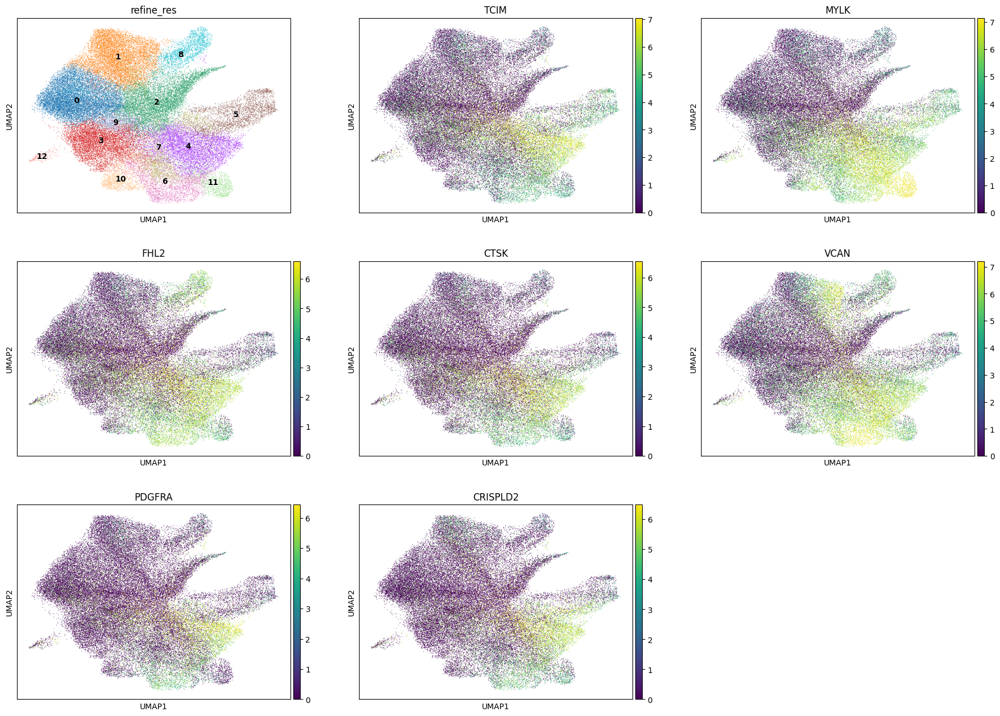

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 6516
Percentage of cells in cluster 4: 11.8


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast/Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast/Myofibroblast'

### 5.6. Cluster 5

In [61]:
cluster_id = '5'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,39.9
1,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,38.2
2,NA,NA,NA,9.1
3,Unknown,Unknown,normal_cell,3.8
4,T,T,normal_cell,3.0


In [63]:
top_ranked_genes[cluster_id]

0       VWF
1      CD93
2    CAVIN1
3    PECAM1
4    ANGPT2
5      CD34
6    ADGRL4
Name: 5, dtype: object

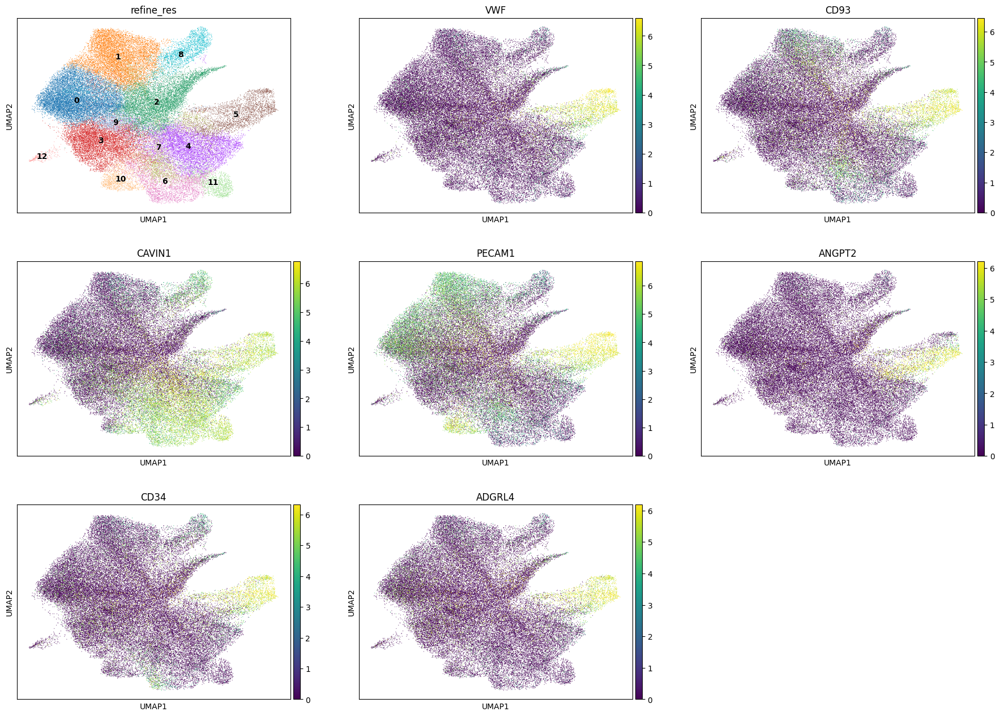

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 3052
Percentage of cells in cluster 5: 5.5


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Angiogenic_endothelial_cell'

### 5.7. Cluster 6

In [67]:
cluster_id = '6'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,52.0
1,T,T,normal_cell,14.1
2,NA,NA,NA,9.1
3,Unknown,Unknown,normal_cell,8.1
4,T,T_CD8,normal_cell,4.8


In [69]:
top_ranked_genes[cluster_id]

0    FBLN1
1    THBS2
2     FBN1
3     VCAN
4    LTBP2
5    SFRP4
6    MFAP5
Name: 6, dtype: object

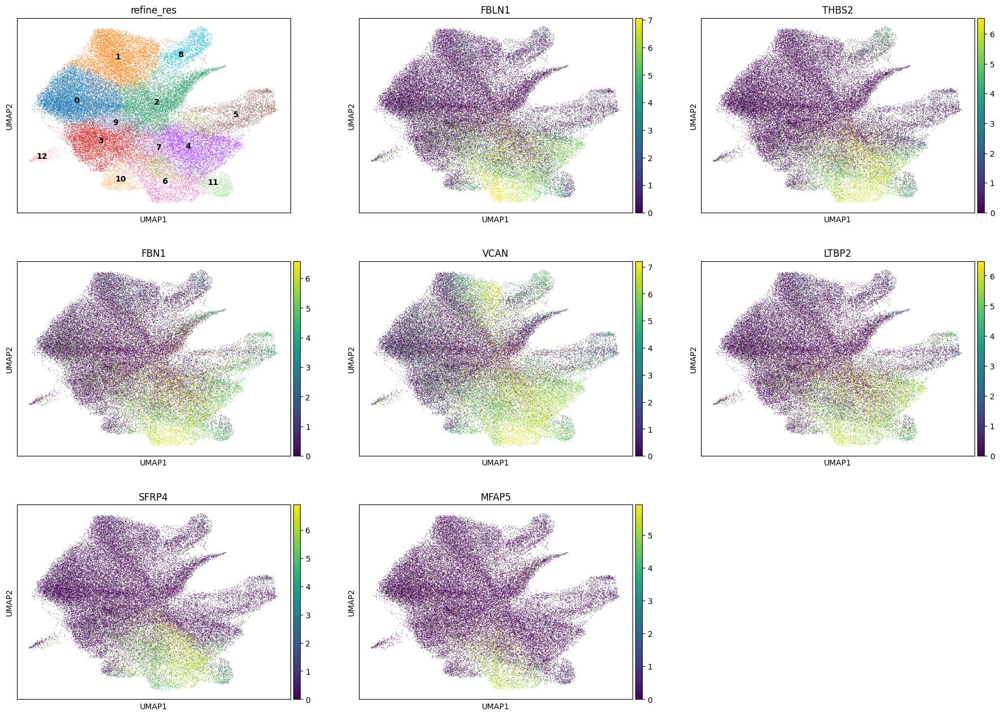

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 2988
Percentage of cells in cluster 6: 5.4


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.8. Cluster 7

In [73]:
cluster_id = '7'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,56.2
1,Unknown,Unknown,normal_cell,11.8
2,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,11.4
3,NA,NA,NA,8.7
4,T,T,normal_cell,5.5


In [75]:
top_ranked_genes[cluster_id]

0    MS4A6A
1     CD163
2     MPEG1
3      CD14
4      MRC1
5    MS4A4A
6      MYLK
Name: 7, dtype: object

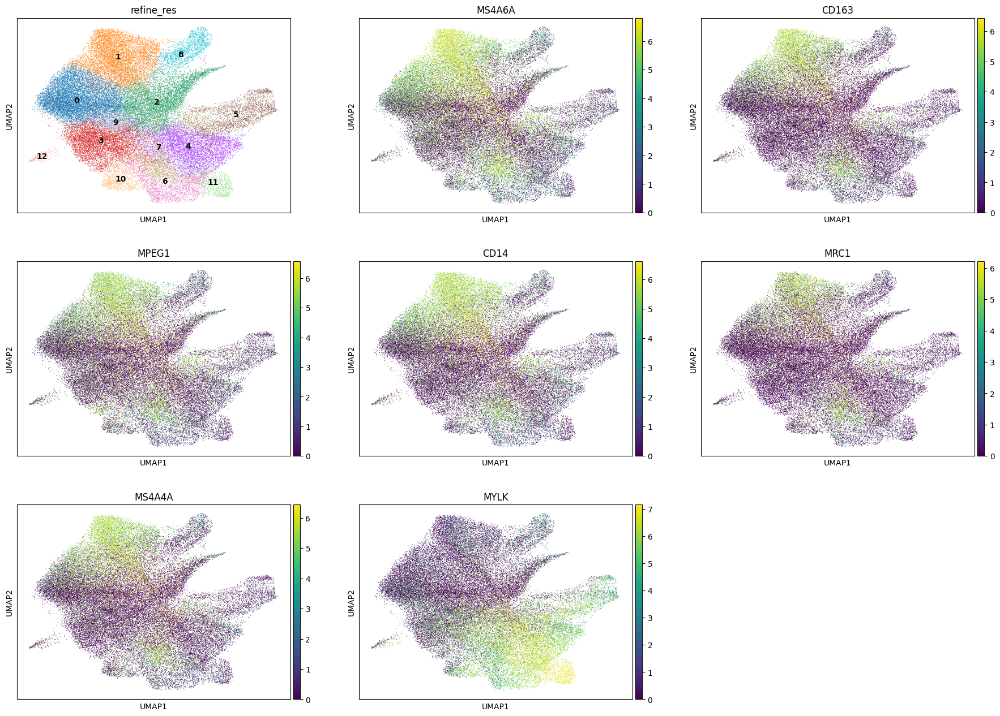

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 2722
Percentage of cells in cluster 7: 4.9


In [78]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.9. Cluster 8

In [79]:
cluster_id = '8'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T_CD8,normal_cell,36.7
1,Epithelial,Renal_epithelial_cell,cancer_cell,36.6
2,Unknown,Unknown,normal_cell,12.0
3,NA,NA,NA,4.5
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,3.9


In [81]:
top_ranked_genes[cluster_id]

0         MET
1         CFB
2    C15orf48
3      SEMA3C
4        STC1
5        TFPI
6       ANPEP
Name: 8, dtype: object

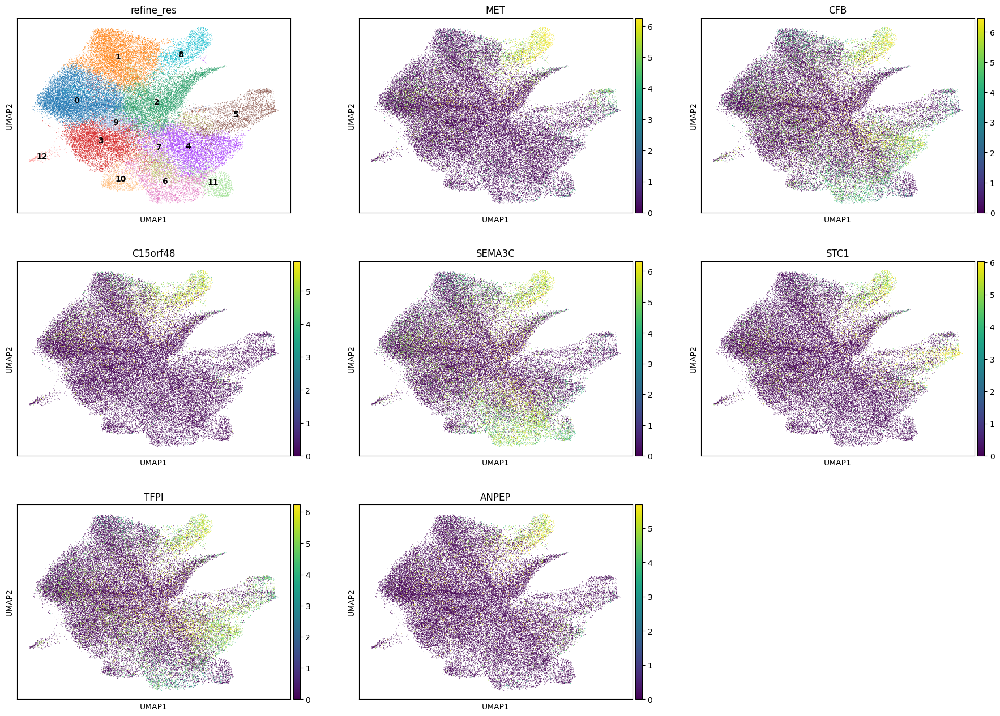

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 2384
Percentage of cells in cluster 8: 4.3


In [84]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Renal_epithelial_cell'

### 5.10. Cluster 9

In [85]:
cluster_id = '9'

In [86]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NK,NK,normal_cell,68.4
1,Unknown,Unknown,normal_cell,7.9
2,T,T,normal_cell,7.5
3,NA,NA,NA,7.4
4,T,T_CD8,normal_cell,6.2


In [87]:
top_ranked_genes[cluster_id]

0     GNLY
1     PRF1
2    KLRD1
3     CCL5
4    CXCR4
5    KLRC1
6    CD247
Name: 9, dtype: object

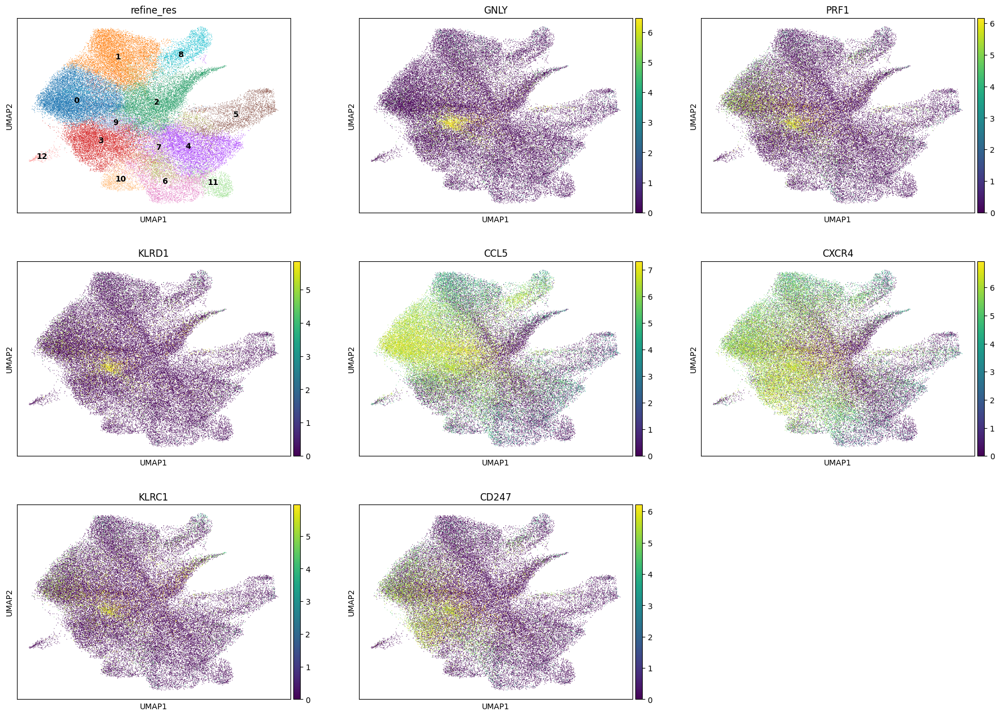

In [88]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 1686
Percentage of cells in cluster 9: 3.1


In [90]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'NK'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'NK'

### 5.11. Cluster 10

In [91]:
cluster_id = '10'

In [92]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,60.0
1,NA,NA,NA,9.7
2,Unknown,Unknown,normal_cell,8.3
3,T,T,normal_cell,5.9
4,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,5.3


In [93]:
top_ranked_genes[cluster_id]

0      MZB1
1    TENT5C
2     CD79A
3    FKBP11
4    SLAMF7
5    PECAM1
6     PRDM1
Name: 10, dtype: object

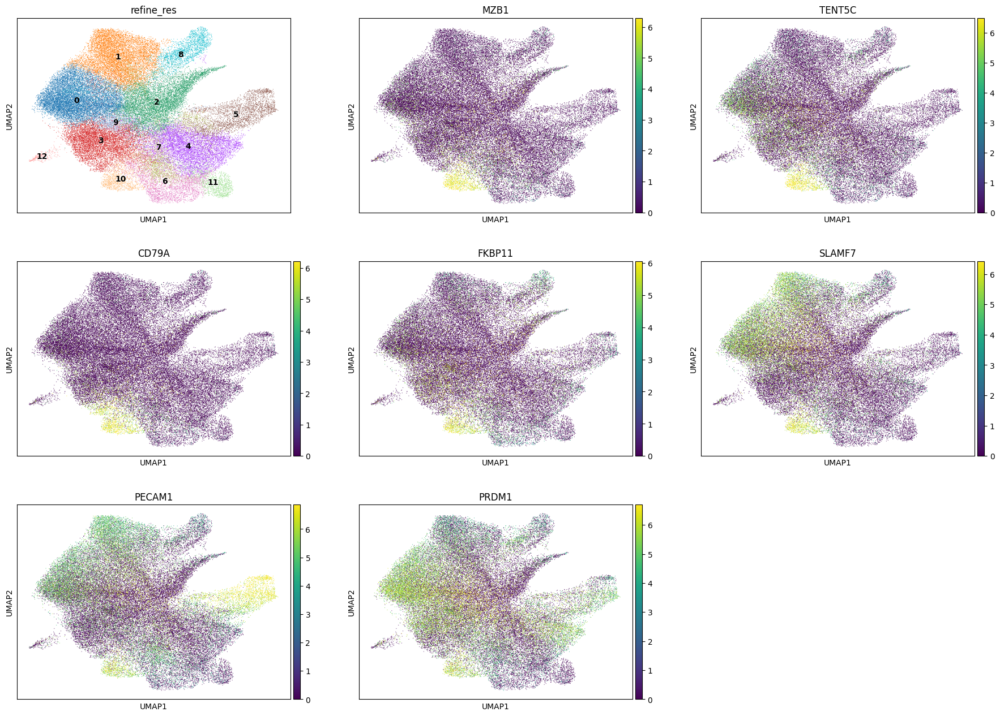

In [94]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [95]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 1395
Percentage of cells in cluster 10: 2.5


In [96]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.12. Cluster 11

In [97]:
cluster_id = '11'

In [98]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Perivascular,Smooth_muscle_cell_and_pericyte,normal_cell,56.5
1,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,17.3
2,NA,NA,NA,16.7
3,Unknown,Unknown,normal_cell,3.3
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,3.2


In [99]:
top_ranked_genes[cluster_id]

0       DES
1     MYH11
2      CNN1
3      MYLK
4     ACTG2
5     ACTA2
6    CAVIN1
Name: 11, dtype: object

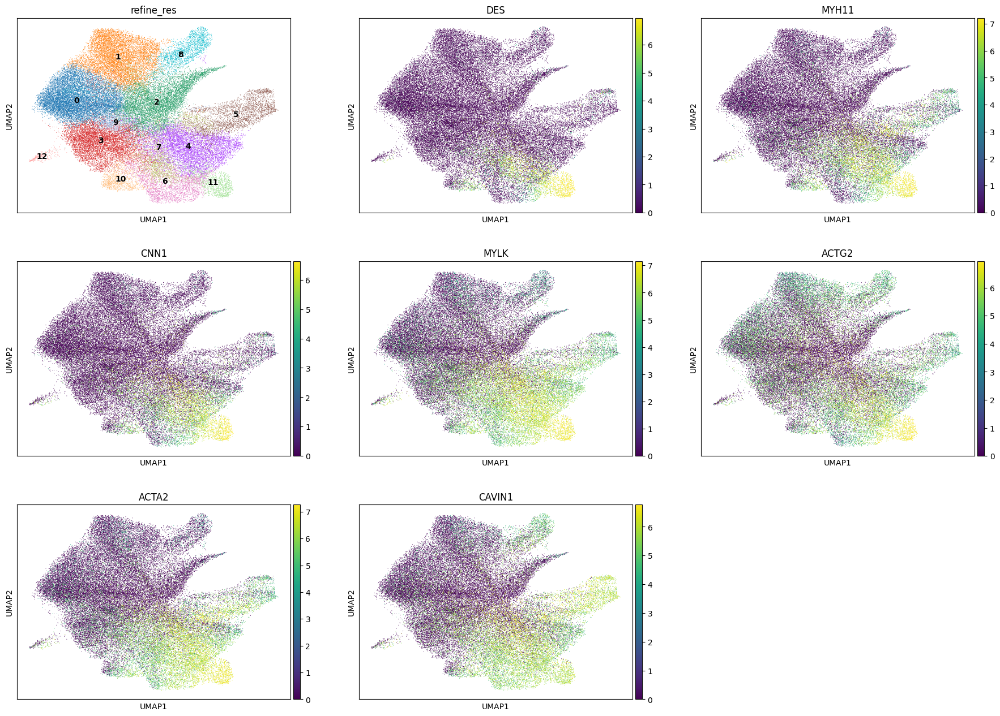

In [100]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [101]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 1189
Percentage of cells in cluster 11: 2.2


In [102]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.13. Cluster 12

In [103]:
cluster_id = '12'

In [104]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,65.1
1,NA,NA,NA,14.0
2,Unknown,Unknown,normal_cell,9.7
3,T,T,normal_cell,3.1
4,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,3.1


In [105]:
top_ranked_genes[cluster_id]

0       CPA3
1        KIT
2      MS4A2
3    SLC18A2
4     IL1RL1
5      GATA2
6      VWA5A
Name: 12, dtype: object

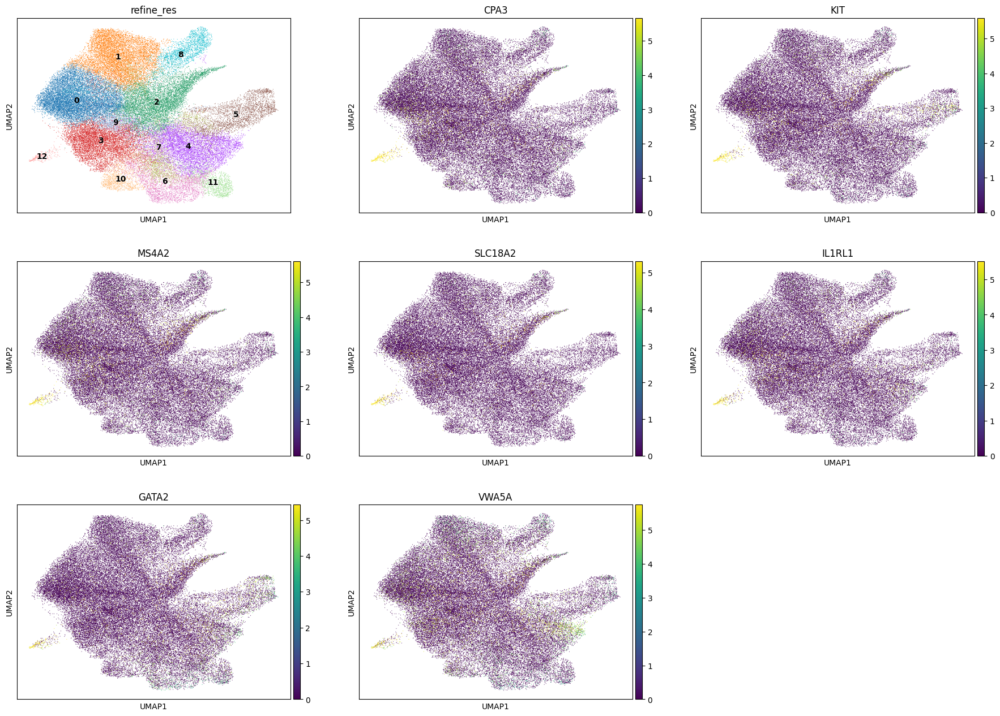

In [106]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [107]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 258
Percentage of cells in cluster 12: 0.5


In [108]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

## 6. Cancer cells

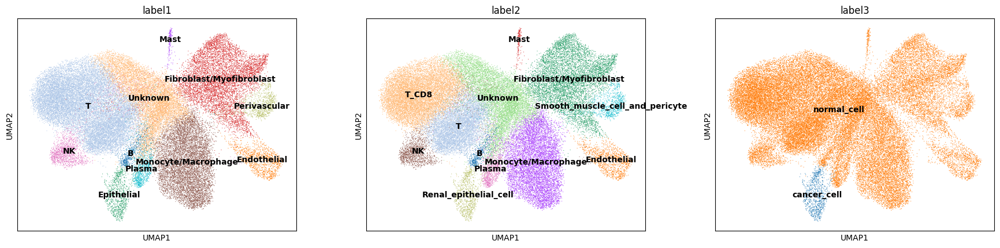

In [111]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

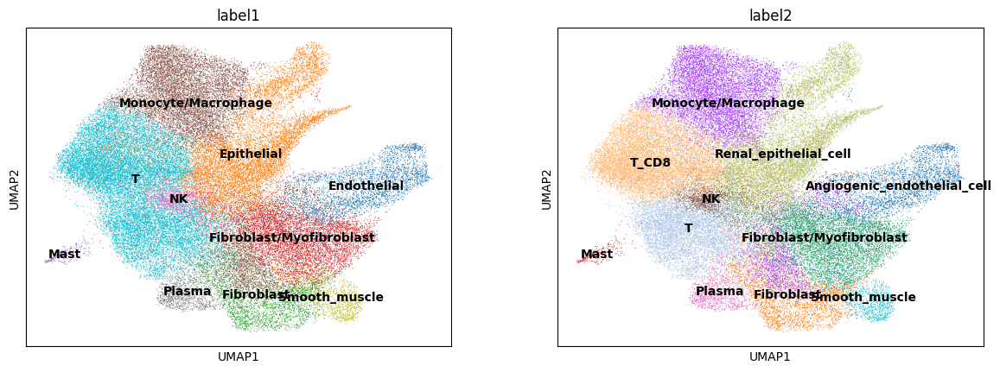

In [112]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [113]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == '8', 'label3'] = 'cancer_cell'

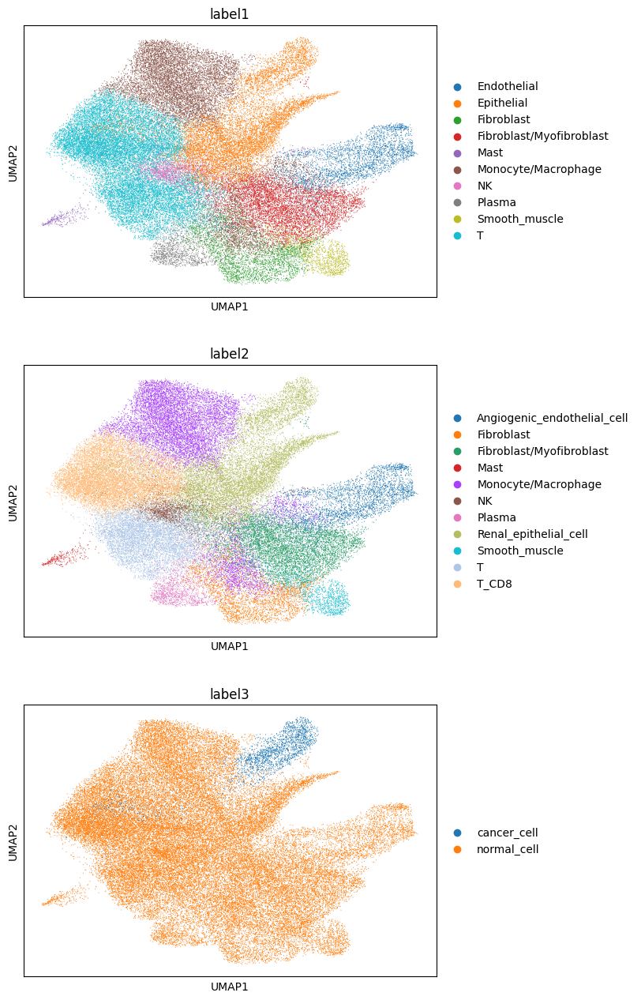

In [114]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [115]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,36,0,0,0,0,36,182.611882,20.817032,cell_labels,0,1,2,2,Epithelial,Renal_epithelial_cell,normal_cell
1,aaaaaaab-1,203,0,0,0,0,203,772.713778,41.272814,cell_labels,1,3,6,6,Fibroblast,Fibroblast,normal_cell
2,aaaaaaac-1,208,0,0,0,0,208,520.109706,63.038127,cell_labels,1,3,7,7,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
3,aaaaaaad-1,98,0,1,0,0,99,774.520028,27.680782,cell_labels,0,1,6,6,Fibroblast,Fibroblast,normal_cell
4,aaaaaaae-1,139,0,0,1,0,140,948.958628,43.124220,cell_labels,1,3,6,6,Fibroblast,Fibroblast,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56505,aaaanmlj-1,52,0,0,0,0,52,90.673753,26.461563,cell_labels,0,0,0,0,T,T_CD8,normal_cell
56506,aaaanmlk-1,43,0,0,0,0,43,228.084227,18.062501,cell_labels,0,4,2,2,Epithelial,Renal_epithelial_cell,normal_cell
56507,aaaanmll-1,96,0,0,0,0,96,217.382195,29.577345,cell_labels,2,2,1,1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
56508,aaaanmlm-1,49,0,0,0,0,49,158.769381,10.972969,cell_labels,1,1,4,4,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell


In [116]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")